##### Loading Neccessary libraries

In [2]:
import cv2
from PIL import Image
import random
import os
import re
from tensorflow.keras.preprocessing.image import img_to_array
from tqdm import tqdm
import matplotlib.pyplot as plt
import numpy as np
from sklearn.model_selection import train_test_split

import tensorflow as tf
from tensorflow.keras.layers import Input, Dense ,Conv2D
from tensorflow.keras.models import Model
from tensorflow.keras.utils import plot_model
from keras import layers



###### code to degrade pictures

In [4]:
#creation of LR data
def inter_deg(path):
    #operating on each file
    for file in os.listdir(path):
        factor = random.choice((2,4,8))
        img = cv2.imread(path + '/' + file)
        h, w, _ = img.shape
        #setting new shape with the given factor
        new_height = h // factor
        new_width = w // factor
        
        #Performing resizing and interpolation to degrade image
        img = cv2.resize(img, (new_width, new_height), interpolation = cv2.INTER_CUBIC)
        # resize the image - up
        img = cv2.resize(img, (w, h), interpolation = cv2.INTER_LINEAR)
        
        # save the image
        '''
        if 'Validation' in path:
            cv2.imwrite('Data/Validation/LR/{}'.format(file), img)
        elif 'Test' in path:
            cv2.imwrite('Data/Test/LR/{}'.format(file), img)
        elif 'Train' in path:
            cv2.imwrite('Data/Train/LR/{}'.format(file), img)
        '''
        cv2.imwrite(path+file, img)

In [5]:
#Only run this to create LR images
#inter_deg("../Processed_Data/LR")
#inter_deg("Data/Validation/HR")

##### code for sorting files

In [3]:
#function to sort data in ascending order
def sorted_alphanumeric(data):  
    convert = lambda text: int(text) if text.isdigit() else text.lower()
    alphanum_key = lambda key: [convert(c) for c in re.split('([0-9]+)',key)]
    return sorted(data,key = alphanum_key)

##### Turning images into array of list

In [4]:
#creating of file paths
train_high_img = []
train_low_img = []
val_high_img = []
val_low_img = []

def data_creation(path,data_l):
    #defining the size of the image
    if 'HR' in path:
        SIZE = 1024
    else:
        SIZE = 256
    files = os.listdir(path)
    files = sorted_alphanumeric(files)
    for name in tqdm(files):    
        img = cv2.imread(path+ '/'+name,1)
        # open cv reads images in BGR format so we have to convert it to RGB
        
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        #resizing image
        img = cv2.resize(img, (SIZE, SIZE))
        img = img.astype('float32') / 255.0
        data_l.append(img_to_array(img))
    return data_l

train_high_img = data_creation('Data/Train/HR',train_high_img )
train_low_img = data_creation('Data/Train/LR',train_low_img )
val_high_img = data_creation('Data/Validation/HR',val_high_img )
val_low_img = data_creation('Data/Validation/LR',val_low_img )

100%|██████████| 100/100 [00:04<00:00, 24.12it/s]


In [4]:
#Faster Method
#creating of file paths
train_high_img = []
train_low_img = []

def d_creation(path,data_l):
    files = os.listdir(path)
    files = sorted_alphanumeric(files)
    for name in tqdm(files):
        img = Image.open(path+name)
        img = np.asarray(img)
        if (img.shape[0]!=512) and (img.shape[0]>256):
            img = cv2.resize(img, (512, 512), interpolation = cv2.INTER_CUBIC)
        img = img.astype('float32') / 255.0
        if img.shape[2]!=3:
            img = img[:,:,:3]
        data_l.append(img_to_array(img))
    return data_l

train_high_img = d_creation('../Processed_Data/HR/',train_high_img )
train_low_img = d_creation('../Processed_Data/LR/',train_low_img )

100%|██████████| 2202/2202 [00:04<00:00, 472.55it/s]


In [5]:
print(len(train_high_img))
print(len(train_low_img))

2202
2202


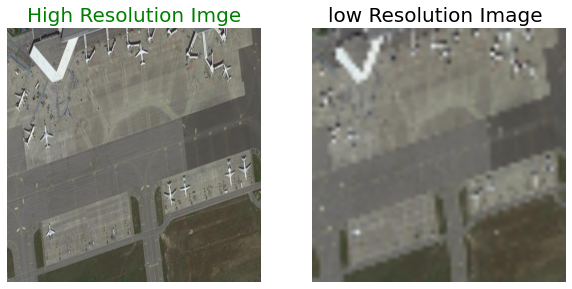

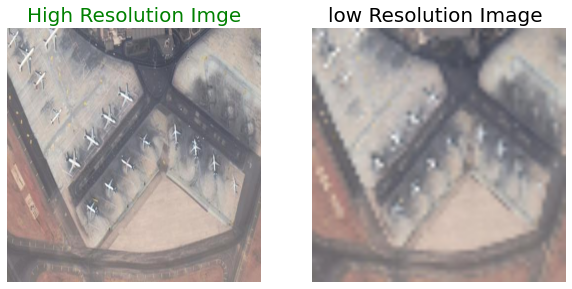

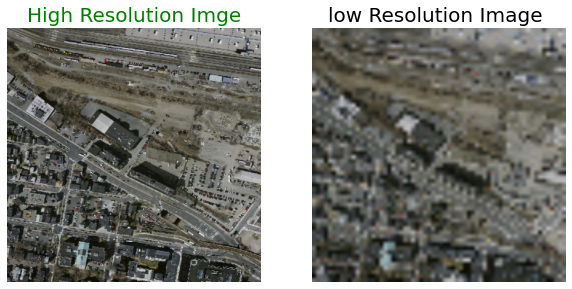

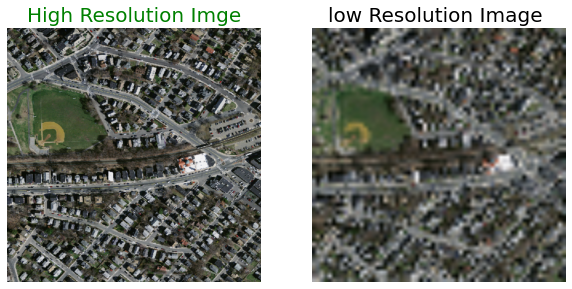

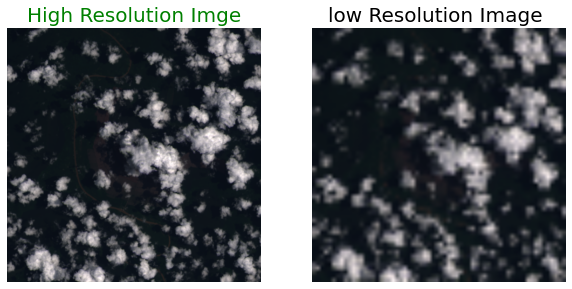

In [6]:
for i in range(5):
    a = np.random.randint(0,100)
    plt.figure(figsize=(10,10))
    plt.subplot(1,2,1)
    plt.title('High Resolution Imge', color = 'green', fontsize = 20)
    plt.imshow(train_high_img[a])
    plt.axis('off')
    plt.subplot(1,2,2)
    plt.title('low Resolution Image ', color = 'black', fontsize = 20)
    plt.imshow(train_low_img[a])
    plt.axis('off')

In [7]:
SIZE = 512
train_high_image = np.reshape(train_high_img,(len(train_high_img),SIZE,SIZE,3))
# val_high_image= np.reshape(val_high_img,(len(val_high_img),SIZE,SIZE,3))
print("Shape of training images:",train_high_image.shape)

Shape of training images: (2202, 512, 512, 3)


In [9]:
SIZE = 256
train_low_image = np.reshape(train_low_img,(len(train_low_img),SIZE,SIZE,3))
#val_low_image = np.reshape(val_low_img,(len(val_low_img),SIZE,SIZE,3))


In [10]:
train_h,val_h ,train_l, val_l =  train_test_split(train_high_image,train_low_image,test_size=0.3,train_size=0.7,random_state=12)

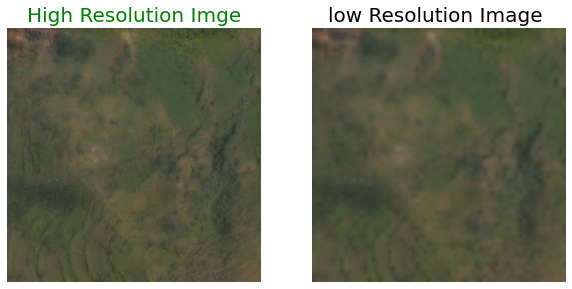

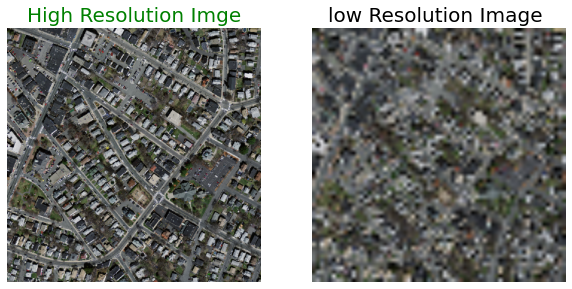

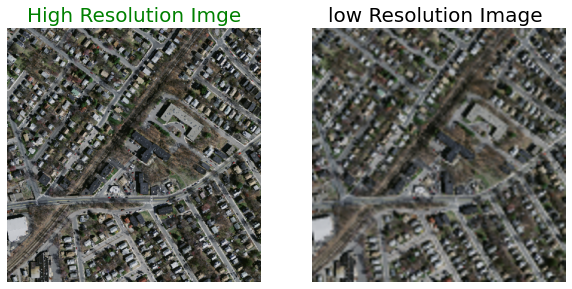

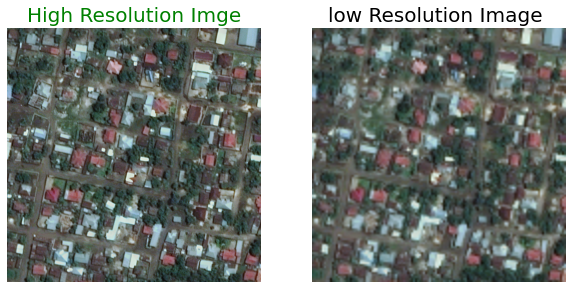

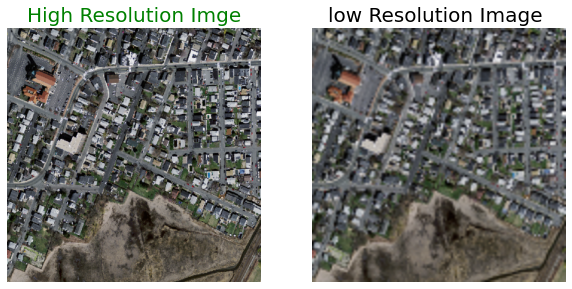

In [11]:
for i in range(5):
    a = np.random.randint(0,100)
    plt.figure(figsize=(10,10))
    plt.subplot(1,2,1)
    plt.title('High Resolution Imge', color = 'green', fontsize = 20)
    plt.imshow(train_h[a])
    plt.axis('off')
    plt.subplot(1,2,2)
    plt.title('low Resolution Image ', color = 'black', fontsize = 20)
    plt.imshow(train_l[a])
    plt.axis('off')

##### Defining The Loss functions

In [12]:
def PSNR(y_true,y_pred):
    mse=tf.reduce_mean( (y_true - y_pred) ** 2 )
    return 20 * log10(1/ (mse ** 0.5))

def log10(x):
    numerator = tf.math.log(x)
    denominator = tf.math.log(tf.constant(10, dtype=numerator.dtype))
    return numerator / denominator

def pixel_MSE(y_true,y_pred):
    return tf.reduce_mean( (y_true - y_pred) ** 2 )

##### Origional SRCNN Model 

In [227]:
input_layer=Input(shape=(None,None,3))
p_extraction= layers.Conv2D(64,9,padding='same',activation='relu') (input_layer)
non_map = layers.Conv2D(32,1,padding='same',activation='relu') (p_extraction)
reconstruction= tf.keras.layers.Conv2D(3,5,padding='same') (non_map)


SRCNN=Model(input_layer,reconstruction)

In [15]:
#perceptual loss
def ssim(y_true,y_pred):
    return 1-tf.reduce_mean(tf.image.ssim(y_true,y_pred,2))


In [228]:
SRCNN.compile(optimizer=tf.keras.optimizers.Adam(0.001),loss=pixel_MSE, metrics=[ssim,'accuracy'])
SRCNN.summary()
#plot_model(SRCNN, to_file ='super_res.png',show_shapes=True)


Model: "model_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_5 (InputLayer)        [(None, None, None, 3)]   0         
                                                                 
 conv2d_14 (Conv2D)          (None, None, None, 64)    15616     
                                                                 
 conv2d_15 (Conv2D)          (None, None, None, 32)    2080      
                                                                 
 conv2d_16 (Conv2D)          (None, None, None, 3)     2403      
                                                                 
Total params: 20099 (78.51 KB)
Trainable params: 20099 (78.51 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [17]:
#Faster Method
#creating of file paths
t_h_img = []
t_l_img = []

def d_creation(path,data_l):
    files = os.listdir(path)
    files = sorted_alphanumeric(files)
    for name in tqdm(files):
        img = Image.open(path+name)
        img = np.asarray(img)
        img = cv2.resize(img, (256, 256))
        img = img.astype('float32') / 255.0
        if img.shape[2]!=3:
            img = img[:,:,:3]
        data_l.append(img_to_array(img))
    return data_l

t_h_img = d_creation('../Processed_Data/HR/',t_h_img )
t_l_img = d_creation('../Processed_Data/LR/',t_l_img )

100%|██████████| 2202/2202 [00:06<00:00, 317.97it/s]


In [18]:
SIZE = 256
t_h_image = np.reshape(t_h_img,(len(t_h_img),SIZE,SIZE,3))
t_l_image = np.reshape(t_l_img,(len(t_l_img),SIZE,SIZE,3))

In [19]:
t_h,v_h ,t_l, v_l =  train_test_split(t_h_image,t_l_image,test_size=0.3,train_size=0.7,random_state=12)

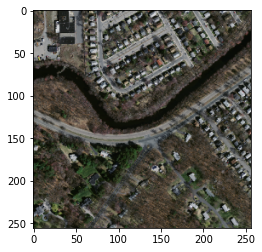

In [23]:
plt.imshow(t_h[0])
plt.show()

In [229]:
his = SRCNN.fit(t_l, t_h,batch_size=1, epochs = 30,validation_data = (v_l,v_h))

Epoch 1/30
1541/1541 [==============================] - 311s 201ms/step - loss: 0.0074 - ssim: 0.2415 - accuracy: 0.5294 - val_loss: 0.0052 - val_ssim: 0.2132 - val_accuracy: 0.6247
Epoch 2/30
1541/1541 [==============================] - 301s 196ms/step - loss: 0.0052 - ssim: 0.2073 - accuracy: 0.6733 - val_loss: 0.0048 - val_ssim: 0.2042 - val_accuracy: 0.7535
Epoch 3/30
1541/1541 [==============================] - 302s 196ms/step - loss: 0.0052 - ssim: 0.2042 - accuracy: 0.6971 - val_loss: 0.0048 - val_ssim: 0.2038 - val_accuracy: 0.7383
Epoch 4/30
1541/1541 [==============================] - 300s 195ms/step - loss: 0.0050 - ssim: 0.2003 - accuracy: 0.7237 - val_loss: 0.0047 - val_ssim: 0.1999 - val_accuracy: 0.7506
Epoch 5/30
1541/1541 [==============================] - 299s 194ms/step - loss: 0.0050 - ssim: 0.2009 - accuracy: 0.7065 - val_loss: 0.0047 - val_ssim: 0.1990 - val_accuracy: 0.7712
Epoch 6/30
1541/1541 [==============================] - 298s 193ms/step - loss: 0.0049 - s

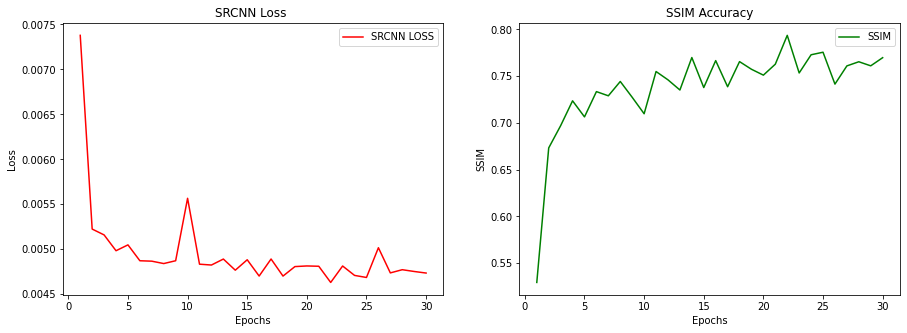

In [288]:
epochs = range(1, len(his.history['loss']) + 1)  # Assuming model1_loss and model2_loss have the same length
plt.figure(figsize=(15,5))
plt.subplot(1,2,1)
plt.plot(epochs, his.history['loss'], 'r', label='SRCNN LOSS')
plt.title('SRCNN Loss ')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.subplot(1,2,2)
plt.plot(epochs, his.history['accuracy'], 'g', label='SSIM')
plt.title('SSIM Accuracy')
plt.xlabel('Epochs')
plt.ylabel('SSIM')
plt.legend()
plt.savefig('nr.jpg')
plt.show()

##### my model

In [47]:
input_layer = Input(shape=(None,None,3))
#patch extraction layer
factor=2
layer_1= layers.Conv2D(64,9,padding='same',activation='relu') (input_layer)
#Non-linear layer
layer_2= layers.Conv2D(32,1,padding='same',activation='relu') (layer_1)
#upsample layer
x = layers.Conv2D(32*(factor**2), 3, padding="same")(layer_2)
x = tf.nn.depth_to_space(x, block_size=factor)
#output layer
layer_3 = tf.keras.layers.Conv2D(3,5,padding='same',activation='sigmoid') (x)

SRCNN_Model = Model(input_layer,layer_3)


In [48]:
SRCNN_Model.compile(optimizer=tf.keras.optimizers.Adam(0.001),loss=ssim, metrics=[ssim,'accuracy'])
SRCNN_Model.summary()
#plot_model(SRCNN_Model, to_file ='SRCNN1.png',show_shapes=True)


Model: "model_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_4 (InputLayer)        [(None, None, None, 3)]   0         
                                                                 
 conv2d_10 (Conv2D)          (None, None, None, 64)    15616     
                                                                 
 conv2d_11 (Conv2D)          (None, None, None, 32)    2080      
                                                                 
 conv2d_12 (Conv2D)          (None, None, None, 128)   36992     
                                                                 
 tf.nn.depth_to_space_1 (TF  (None, None, None, 32)    0         
 OpLambda)                                                       
                                                                 
 conv2d_13 (Conv2D)          (None, None, None, 3)     2403      
                                                           

In [55]:
s_m = SRCNN_Model.fit(train_l, train_h, batch_size=1, epochs = 25,
          validation_data = (val_l,val_h))

Epoch 1/25
1541/1541 [==============================] - 1547s 1s/step - loss: 0.2705 - ssim: 0.2705 - accuracy: 0.7083 - val_loss: 0.2714 - val_ssim: 0.2714 - val_accuracy: 0.7357
Epoch 2/25
1541/1541 [==============================] - 1539s 999ms/step - loss: 0.2705 - ssim: 0.2705 - accuracy: 0.7022 - val_loss: 0.2732 - val_ssim: 0.2732 - val_accuracy: 0.5061
Epoch 3/25
1541/1541 [==============================] - 1550s 1s/step - loss: 0.2701 - ssim: 0.2701 - accuracy: 0.7112 - val_loss: 0.2705 - val_ssim: 0.2705 - val_accuracy: 0.7417
Epoch 4/25
1541/1541 [==============================] - 1553s 1s/step - loss: 0.2686 - ssim: 0.2686 - accuracy: 0.7210 - val_loss: 0.2701 - val_ssim: 0.2701 - val_accuracy: 0.7344
Epoch 5/25
1541/1541 [==============================] - 1553s 1s/step - loss: 0.2695 - ssim: 0.2695 - accuracy: 0.7095 - val_loss: 0.2703 - val_ssim: 0.2703 - val_accuracy: 0.5885
Epoch 6/25
1541/1541 [==============================] - 1553s 1s/step - loss: 0.2681 - ssim: 0.26

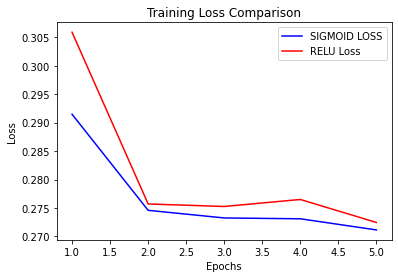

In [54]:
epochs = range(1, len(s_m.history.get('loss')) + 1)  # Assuming model1_loss and model2_loss have the same length

plt.plot(epochs, s_m.history.get('loss'), 'b', label='SIGMOID LOSS')
plt.plot(epochs, re_m.history.get('loss'), 'r', label='RELU Loss')

plt.title('Training Loss Comparison')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.savefig('m_srcnn_loss.jpg')
plt.show()

In [304]:
def plot_images(high,low,predicted):
    if isinstance(low, np.ndarray):
        plt.figure(figsize=(15,15))
        plt.subplot(1,3,1)
        plt.title('High Image', color = 'green', fontsize = 20)
        plt.imshow(high)
        plt.subplot(1,3,2)
        plt.title('Low Image ', color = 'black', fontsize = 20)
        plt.imshow(low)
        plt.subplot(1,3,3)
        plt.title('Predicted Image ', color = 'Red', fontsize = 20)
        plt.imshow(predicted)
    else:
        plt.figure(figsize=(15,15))
        plt.subplot(1,2,1)
        plt.title('High Image', color = 'green', fontsize = 20)
        plt.imshow(high)
        plt.subplot(1,2,2)
        plt.title('Predicted Image ', color = 'Red', fontsize = 20)
        plt.imshow(predicted)

    plt.show()

1/1 [==============================] - 0s 26ms/step


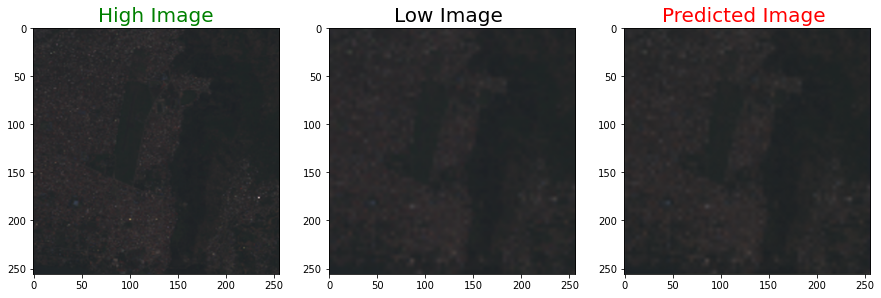

PSNR tf.Tensor(38.47939, shape=(), dtype=float32) dB SSIM tf.Tensor(0.91749, shape=(), dtype=float32)
1/1 [==============================] - 0s 20ms/step


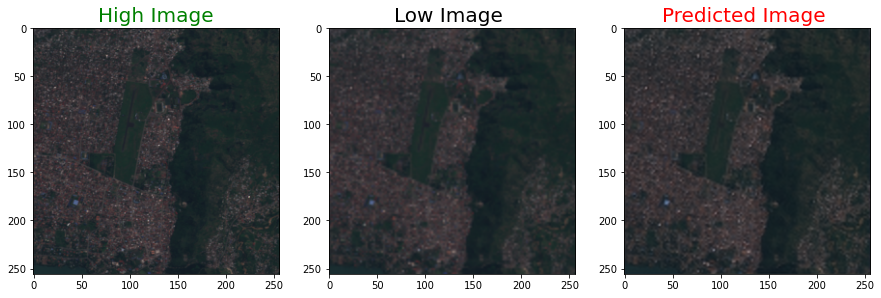

PSNR tf.Tensor(34.392807, shape=(), dtype=float32) dB SSIM tf.Tensor(0.8731475, shape=(), dtype=float32)
1/1 [==============================] - 0s 21ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


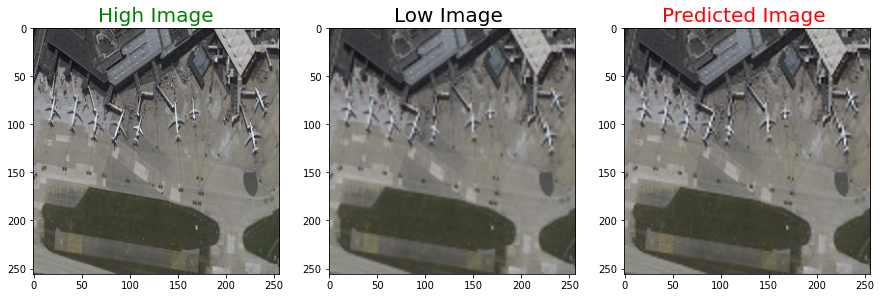

PSNR tf.Tensor(28.170137, shape=(), dtype=float32) dB SSIM tf.Tensor(0.86522263, shape=(), dtype=float32)
1/1 [==============================] - 0s 20ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


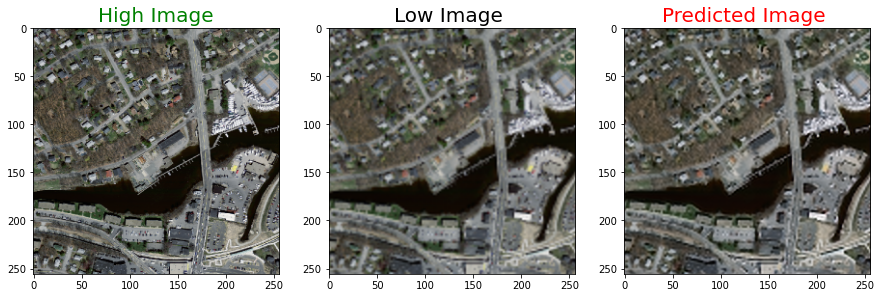

PSNR tf.Tensor(23.608477, shape=(), dtype=float32) dB SSIM tf.Tensor(0.79384756, shape=(), dtype=float32)
1/1 [==============================] - 0s 27ms/step


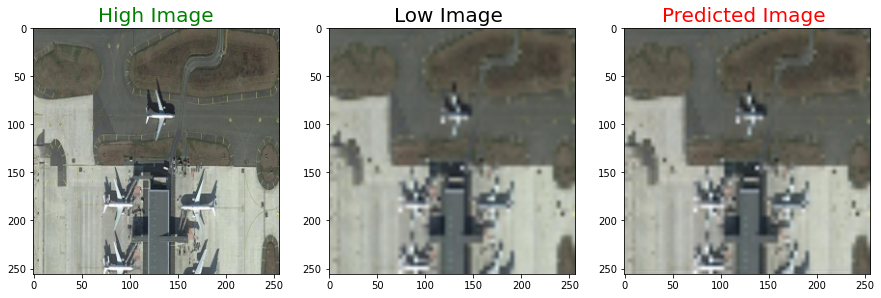

PSNR tf.Tensor(24.005096, shape=(), dtype=float32) dB SSIM tf.Tensor(0.6998847, shape=(), dtype=float32)
1/1 [==============================] - 0s 30ms/step


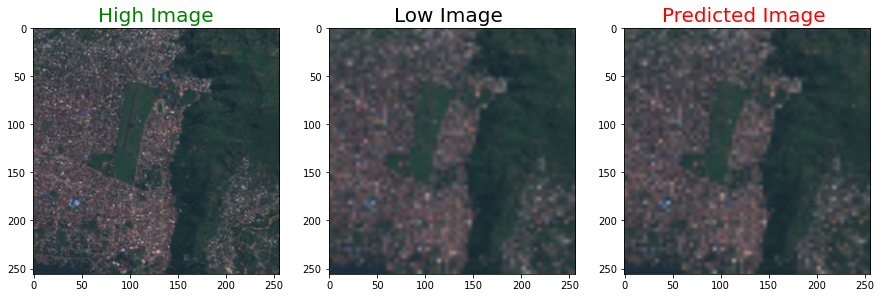

PSNR tf.Tensor(27.330936, shape=(), dtype=float32) dB SSIM tf.Tensor(0.65180576, shape=(), dtype=float32)
1/1 [==============================] - 0s 21ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


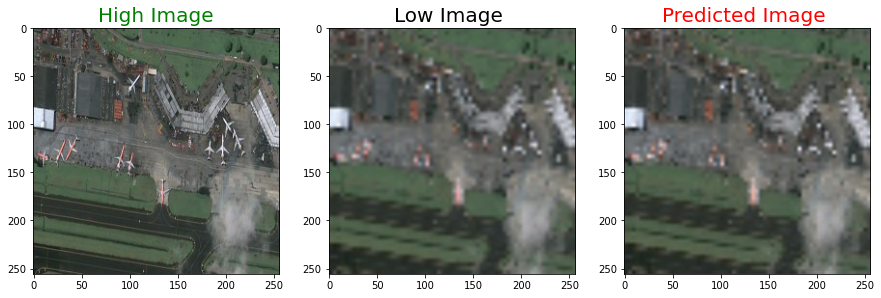

PSNR tf.Tensor(24.167408, shape=(), dtype=float32) dB SSIM tf.Tensor(0.6227676, shape=(), dtype=float32)
1/1 [==============================] - 0s 21ms/step


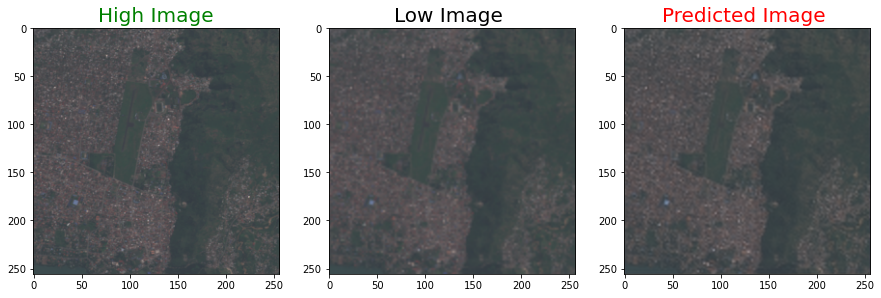

PSNR tf.Tensor(36.308277, shape=(), dtype=float32) dB SSIM tf.Tensor(0.89617103, shape=(), dtype=float32)
1/1 [==============================] - 0s 22ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


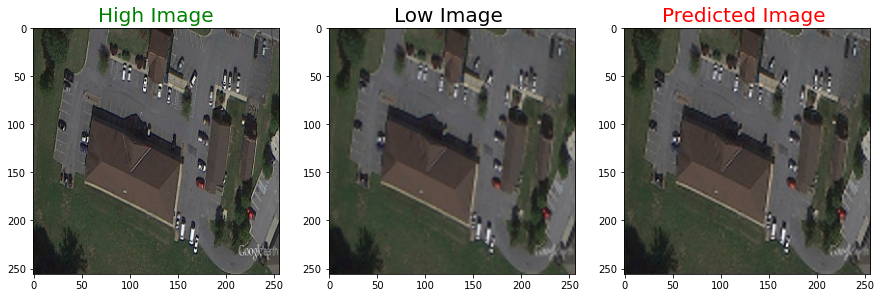

PSNR tf.Tensor(27.392294, shape=(), dtype=float32) dB SSIM tf.Tensor(0.809889, shape=(), dtype=float32)
1/1 [==============================] - 0s 25ms/step


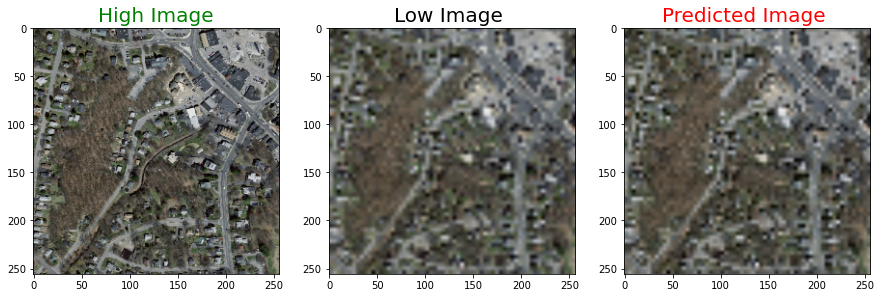

PSNR tf.Tensor(20.381573, shape=(), dtype=float32) dB SSIM tf.Tensor(0.4918697, shape=(), dtype=float32)
1/1 [==============================] - 0s 22ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


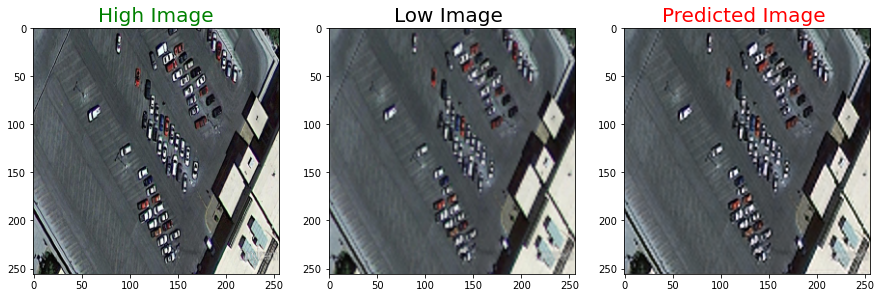

PSNR tf.Tensor(23.921883, shape=(), dtype=float32) dB SSIM tf.Tensor(0.8356726, shape=(), dtype=float32)
1/1 [==============================] - 0s 31ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


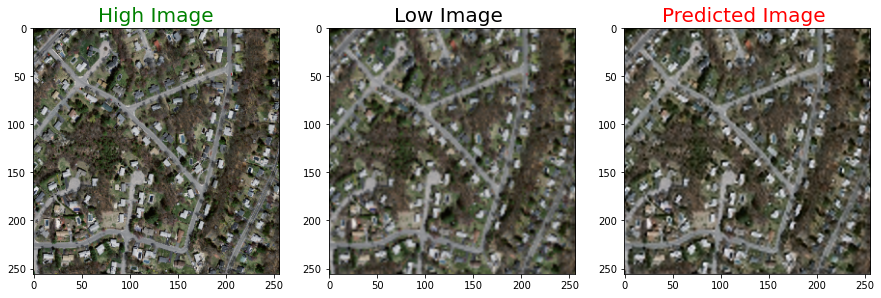

PSNR tf.Tensor(24.102192, shape=(), dtype=float32) dB SSIM tf.Tensor(0.81152916, shape=(), dtype=float32)
1/1 [==============================] - 0s 21ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


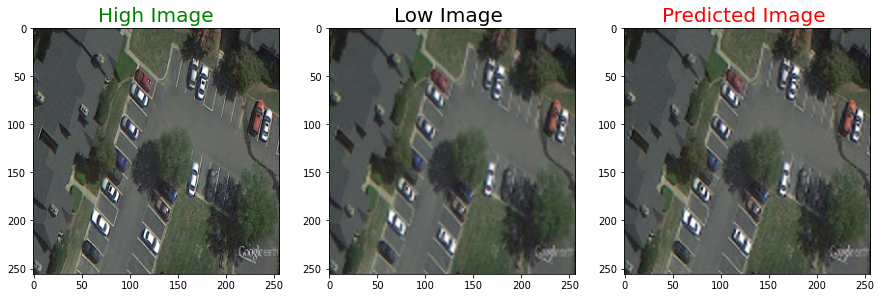

PSNR tf.Tensor(27.01372, shape=(), dtype=float32) dB SSIM tf.Tensor(0.815327, shape=(), dtype=float32)
1/1 [==============================] - 0s 21ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


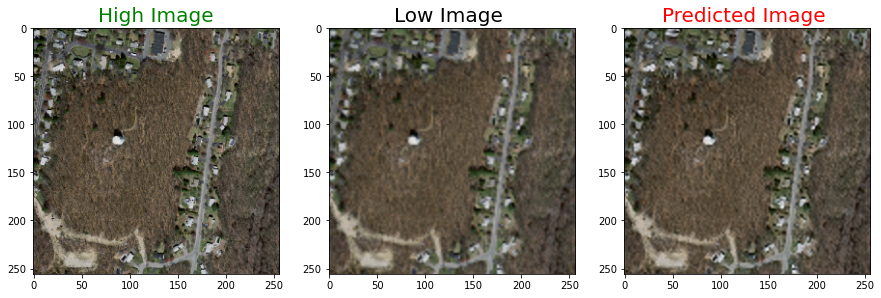

PSNR tf.Tensor(26.422338, shape=(), dtype=float32) dB SSIM tf.Tensor(0.75445145, shape=(), dtype=float32)
1/1 [==============================] - 0s 35ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


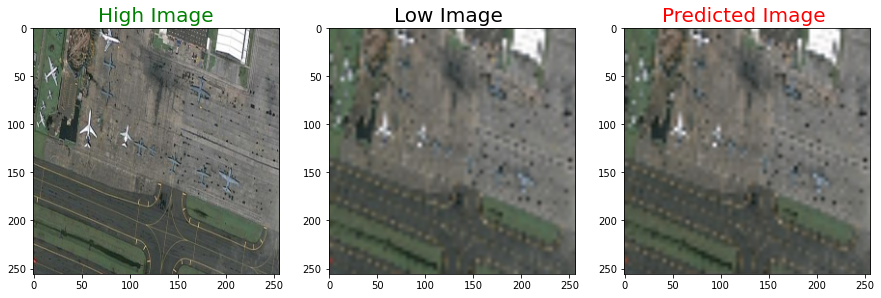

PSNR tf.Tensor(23.983995, shape=(), dtype=float32) dB SSIM tf.Tensor(0.56033444, shape=(), dtype=float32)
1/1 [==============================] - 0s 21ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


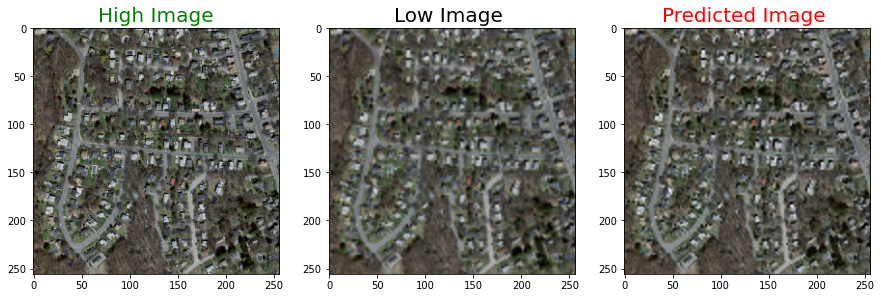

PSNR tf.Tensor(24.755753, shape=(), dtype=float32) dB SSIM tf.Tensor(0.8020103, shape=(), dtype=float32)


In [147]:
for i in range(0,16):
    predicted = SRCNN.predict(t_l_image[i].reshape(1,256, 256,3)).reshape(256, 256,3)
    plot_images(t_h_image[i],t_l_image[i],predicted)
    print('PSNR',PSNR(t_h_image[i],predicted),'dB', "SSIM",tf.image.ssim(t_h_image[i],predicted,max_val=1))

1/1 [==============================] - 0s 145ms/step


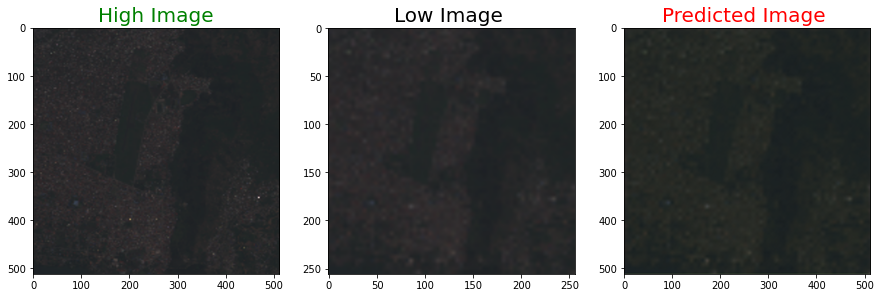

PSNR tf.Tensor(32.807053, shape=(), dtype=float32) dB SSIM tf.Tensor(0.9227442, shape=(), dtype=float32)
1/1 [==============================] - 0s 48ms/step


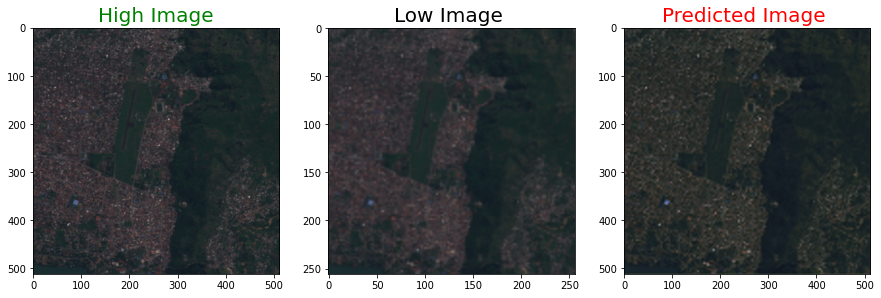

PSNR tf.Tensor(29.450668, shape=(), dtype=float32) dB SSIM tf.Tensor(0.81992084, shape=(), dtype=float32)
1/1 [==============================] - 0s 48ms/step


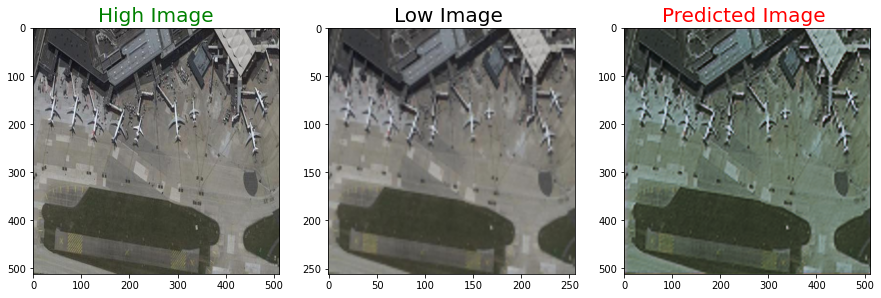

PSNR tf.Tensor(21.520365, shape=(), dtype=float32) dB SSIM tf.Tensor(0.61628085, shape=(), dtype=float32)
1/1 [==============================] - 0s 46ms/step


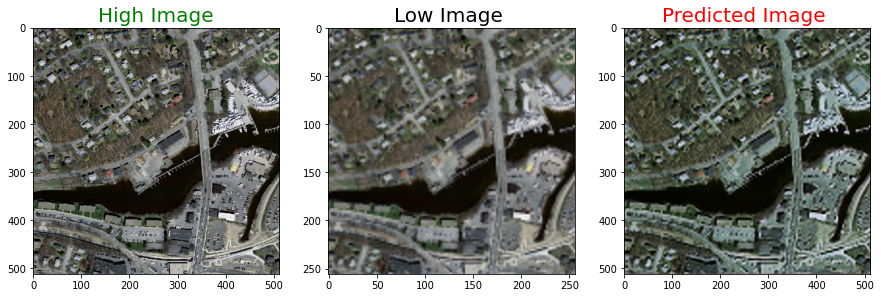

PSNR tf.Tensor(19.296896, shape=(), dtype=float32) dB SSIM tf.Tensor(0.5424292, shape=(), dtype=float32)
1/1 [==============================] - 0s 40ms/step


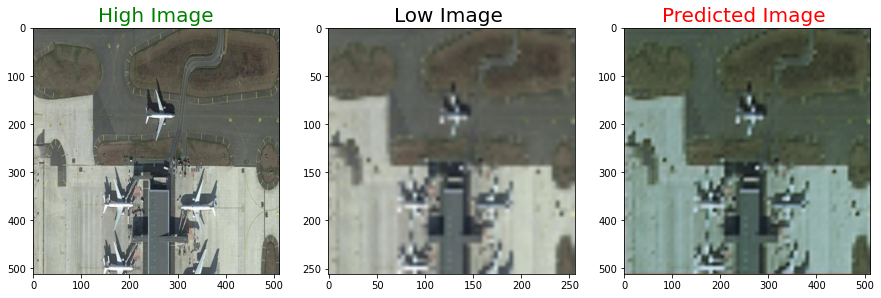

PSNR tf.Tensor(19.128452, shape=(), dtype=float32) dB SSIM tf.Tensor(0.5062441, shape=(), dtype=float32)
1/1 [==============================] - 0s 63ms/step


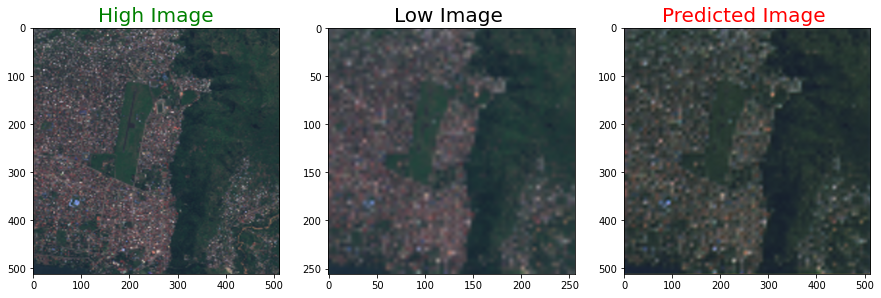

PSNR tf.Tensor(24.044073, shape=(), dtype=float32) dB SSIM tf.Tensor(0.63703567, shape=(), dtype=float32)
1/1 [==============================] - 0s 49ms/step


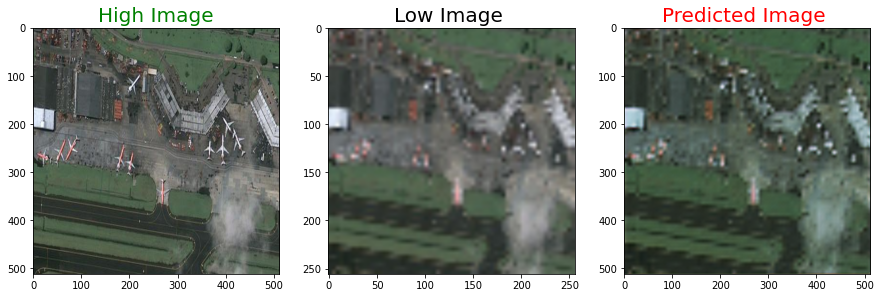

PSNR tf.Tensor(20.7162, shape=(), dtype=float32) dB SSIM tf.Tensor(0.50237024, shape=(), dtype=float32)
1/1 [==============================] - 0s 36ms/step


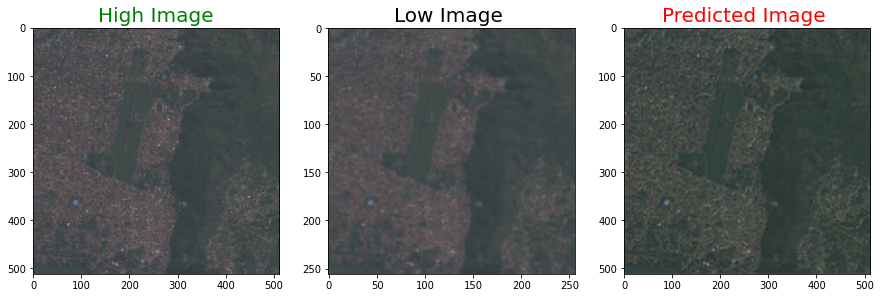

PSNR tf.Tensor(25.771143, shape=(), dtype=float32) dB SSIM tf.Tensor(0.7816727, shape=(), dtype=float32)
1/1 [==============================] - 0s 43ms/step


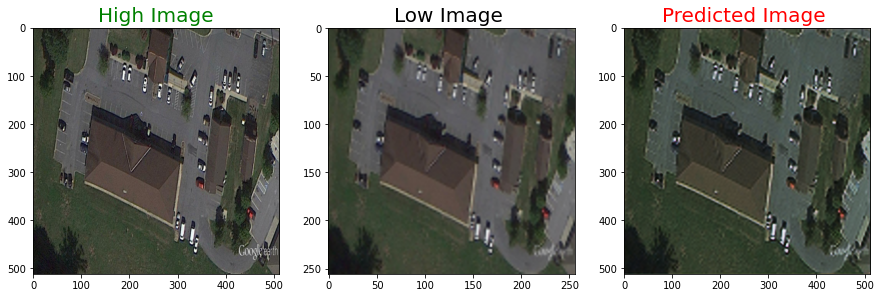

PSNR tf.Tensor(22.861202, shape=(), dtype=float32) dB SSIM tf.Tensor(0.6263049, shape=(), dtype=float32)
1/1 [==============================] - 0s 45ms/step


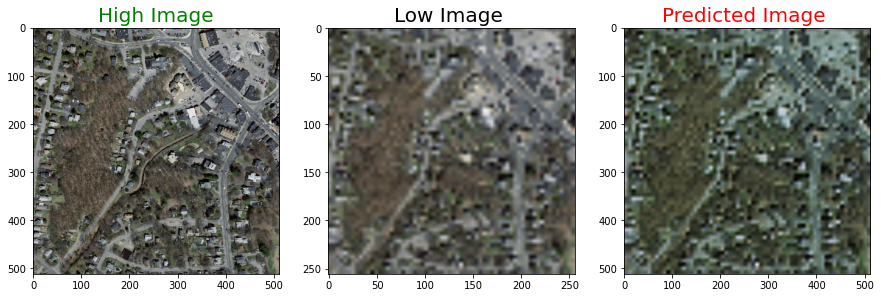

PSNR tf.Tensor(17.86845, shape=(), dtype=float32) dB SSIM tf.Tensor(0.30509493, shape=(), dtype=float32)
1/1 [==============================] - 0s 56ms/step


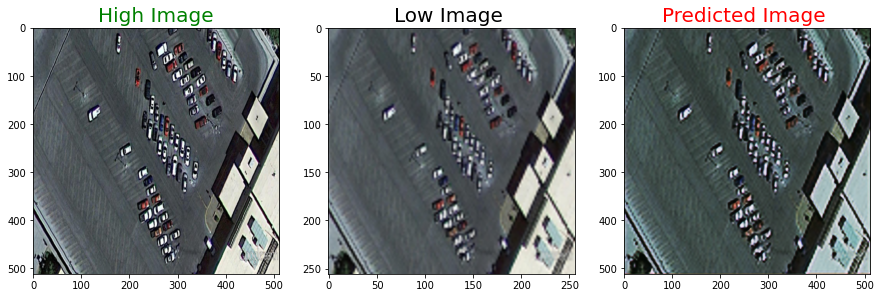

PSNR tf.Tensor(19.838652, shape=(), dtype=float32) dB SSIM tf.Tensor(0.6402897, shape=(), dtype=float32)
1/1 [==============================] - 0s 51ms/step


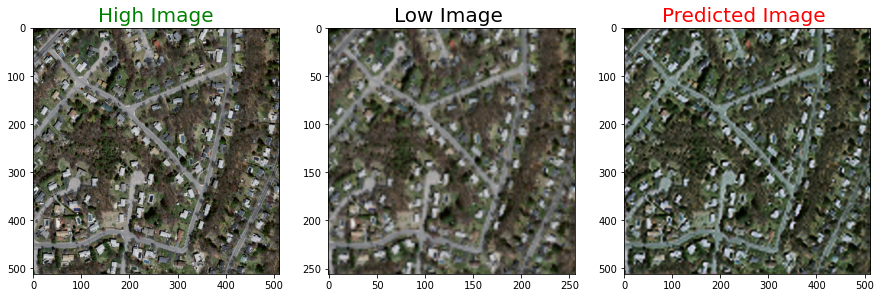

PSNR tf.Tensor(20.033226, shape=(), dtype=float32) dB SSIM tf.Tensor(0.5584211, shape=(), dtype=float32)
1/1 [==============================] - 0s 94ms/step


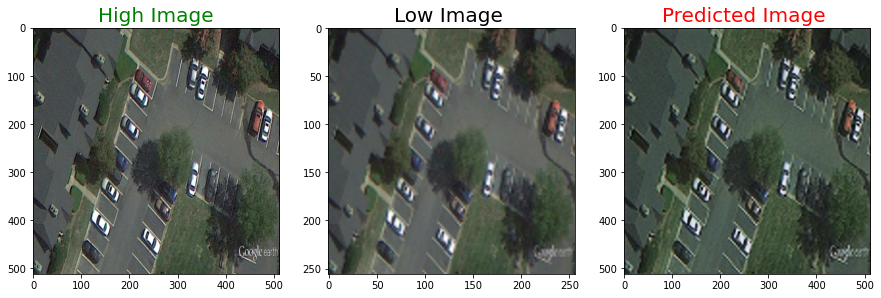

PSNR tf.Tensor(22.395908, shape=(), dtype=float32) dB SSIM tf.Tensor(0.6249834, shape=(), dtype=float32)
1/1 [==============================] - 0s 41ms/step


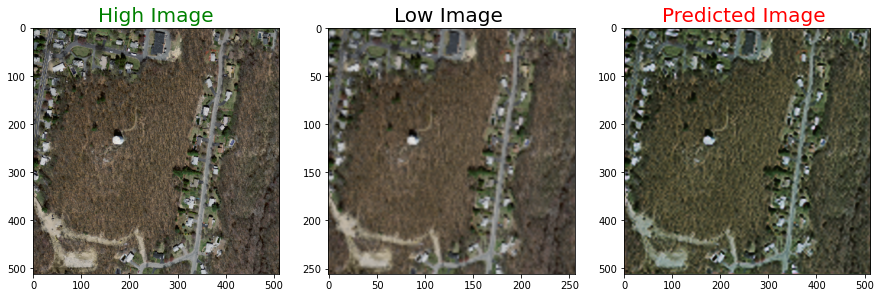

PSNR tf.Tensor(21.43222, shape=(), dtype=float32) dB SSIM tf.Tensor(0.49751672, shape=(), dtype=float32)
1/1 [==============================] - 0s 37ms/step


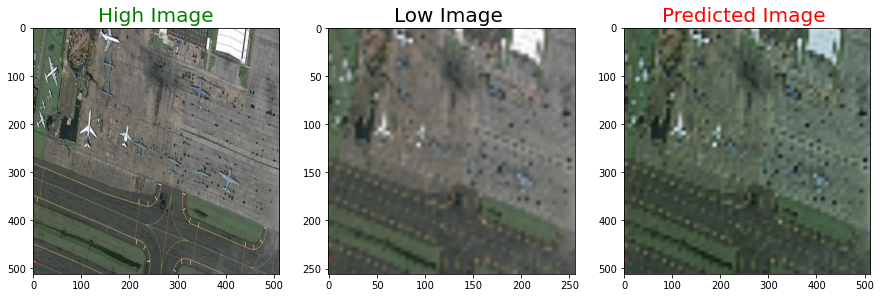

PSNR tf.Tensor(20.031353, shape=(), dtype=float32) dB SSIM tf.Tensor(0.43495715, shape=(), dtype=float32)
1/1 [==============================] - 0s 41ms/step


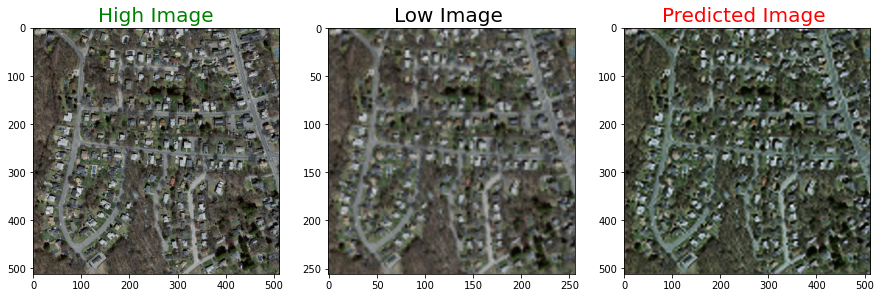

PSNR tf.Tensor(20.759956, shape=(), dtype=float32) dB SSIM tf.Tensor(0.5675857, shape=(), dtype=float32)


In [56]:
for i in range(0,16):
    predicted = s_m.model.predict(train_low_image[i].reshape(1,256, 256,3)).reshape(512,512,3)
    plot_images(train_high_image[i],train_low_image[i],predicted)
    print('PSNR',PSNR(train_high_image[i],predicted),'dB', "SSIM",tf.image.ssim(train_high_image[i],predicted,max_val=1))

##### Measuring Test score For Our SCNN Model

In [309]:
test_high_img = []
test_high_img = d_creation('../Test/',test_high_img )


100%|██████████| 21/21 [00:00<00:00, 781.40it/s]


In [310]:
SIZE = 256
test_image = np.reshape(test_high_img,(len(test_high_img),SIZE,SIZE,3))

1/1 [==============================] - 0s 22ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


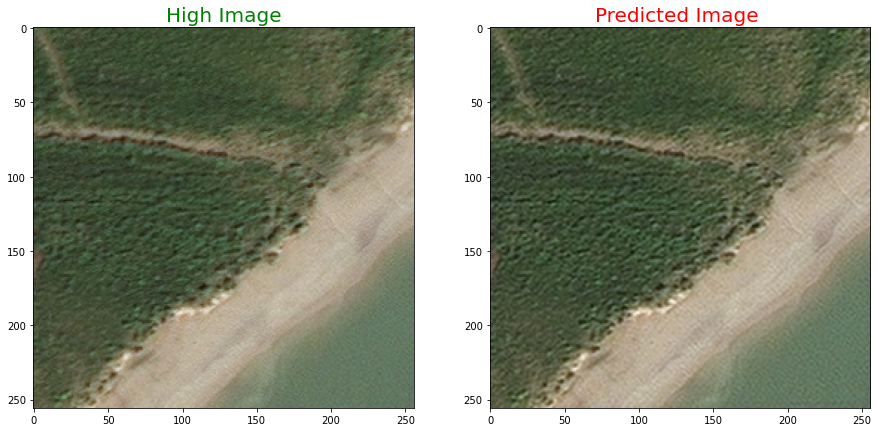

PSNR tf.Tensor(35.06667, shape=(), dtype=float32) dB SSIM tf.Tensor(0.9305265, shape=(), dtype=float32)
1/1 [==============================] - 0s 21ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


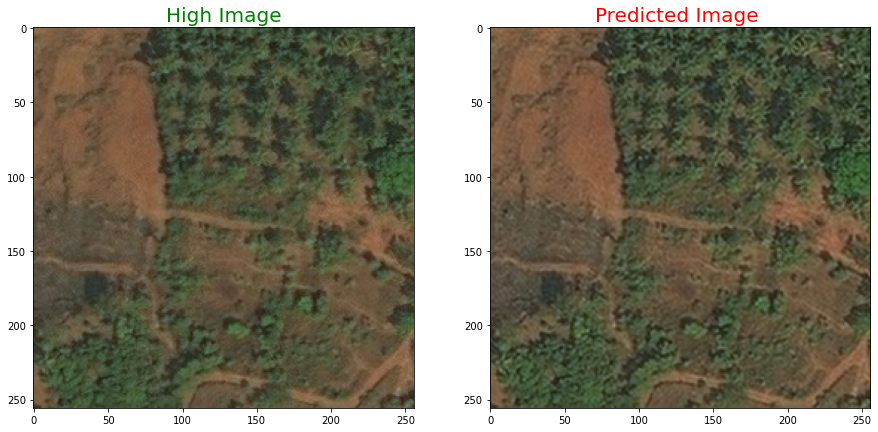

PSNR tf.Tensor(35.485764, shape=(), dtype=float32) dB SSIM tf.Tensor(0.9403594, shape=(), dtype=float32)
1/1 [==============================] - 0s 21ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


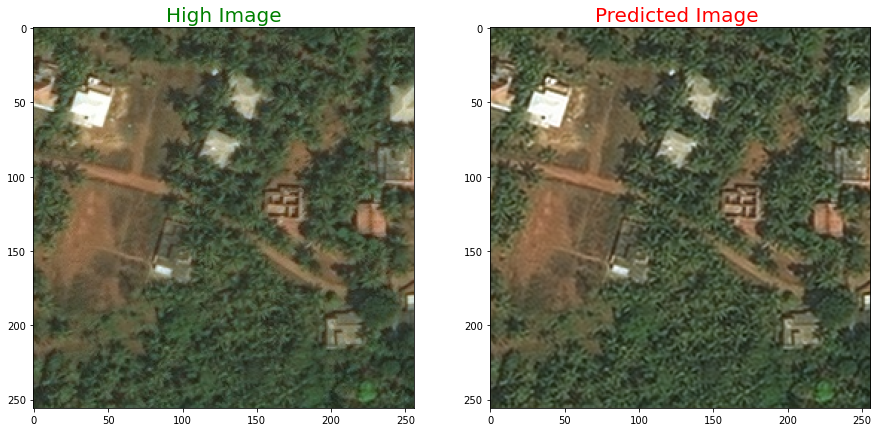

PSNR tf.Tensor(33.064842, shape=(), dtype=float32) dB SSIM tf.Tensor(0.9381544, shape=(), dtype=float32)
1/1 [==============================] - 0s 21ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


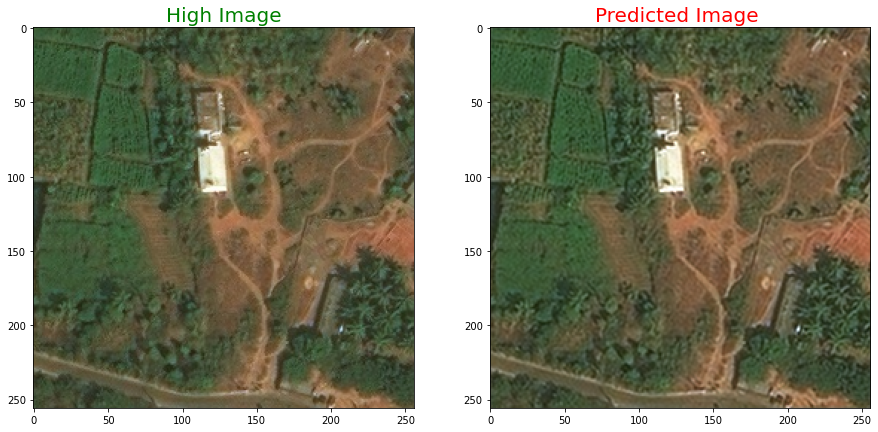

PSNR tf.Tensor(33.766808, shape=(), dtype=float32) dB SSIM tf.Tensor(0.9280658, shape=(), dtype=float32)
1/1 [==============================] - 0s 25ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


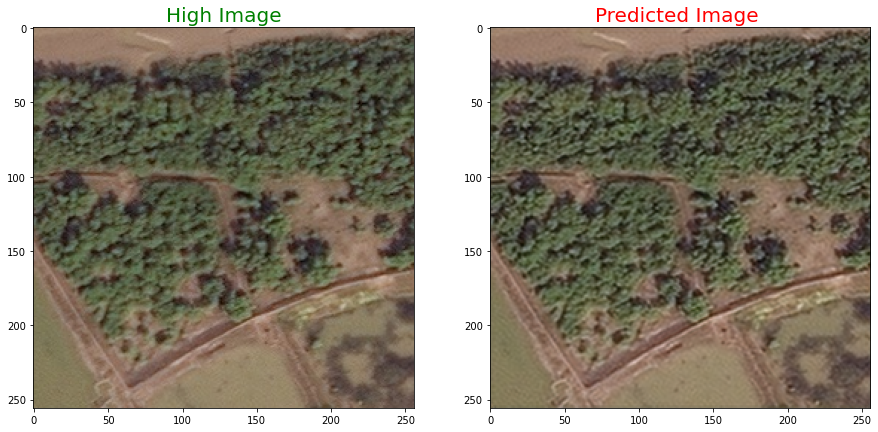

PSNR tf.Tensor(33.426, shape=(), dtype=float32) dB SSIM tf.Tensor(0.94788367, shape=(), dtype=float32)
1/1 [==============================] - 0s 22ms/step


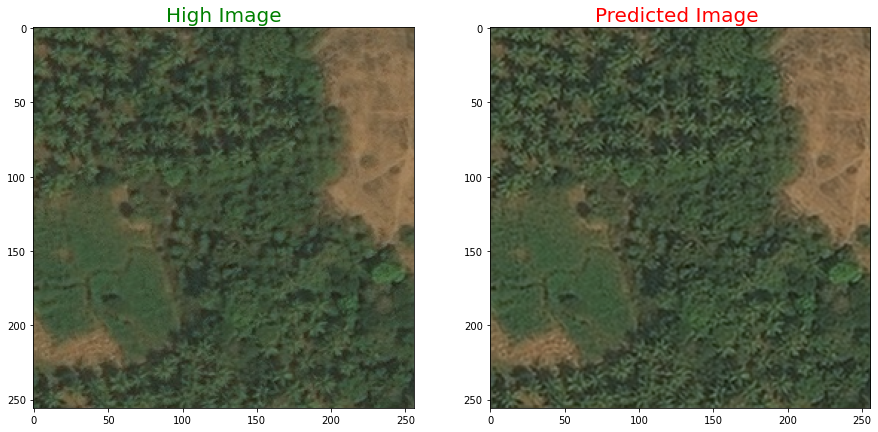

PSNR tf.Tensor(35.63086, shape=(), dtype=float32) dB SSIM tf.Tensor(0.9397196, shape=(), dtype=float32)
1/1 [==============================] - 0s 20ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


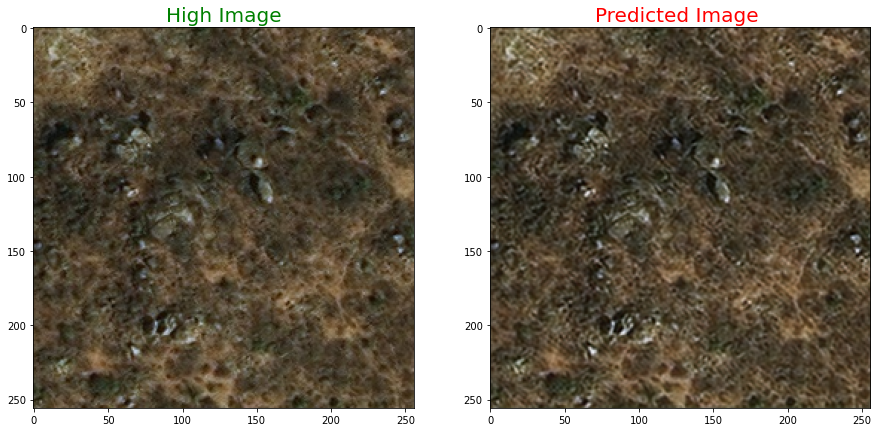

PSNR tf.Tensor(32.125305, shape=(), dtype=float32) dB SSIM tf.Tensor(0.9302911, shape=(), dtype=float32)
1/1 [==============================] - 0s 23ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


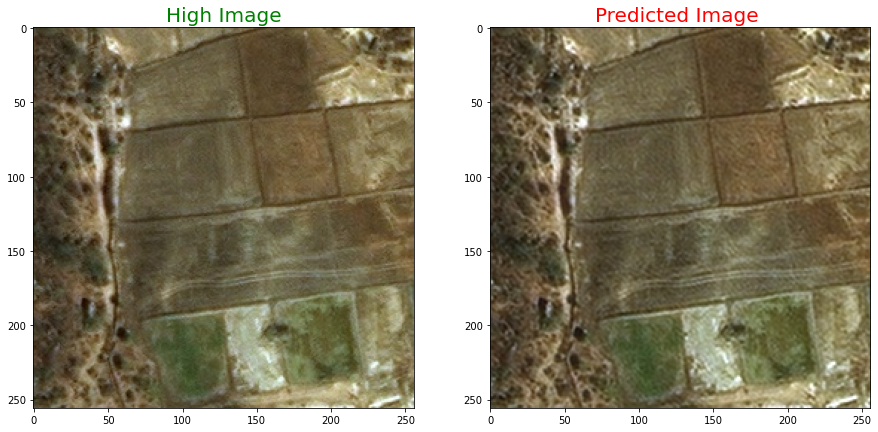

PSNR tf.Tensor(33.572857, shape=(), dtype=float32) dB SSIM tf.Tensor(0.937421, shape=(), dtype=float32)
1/1 [==============================] - 0s 21ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


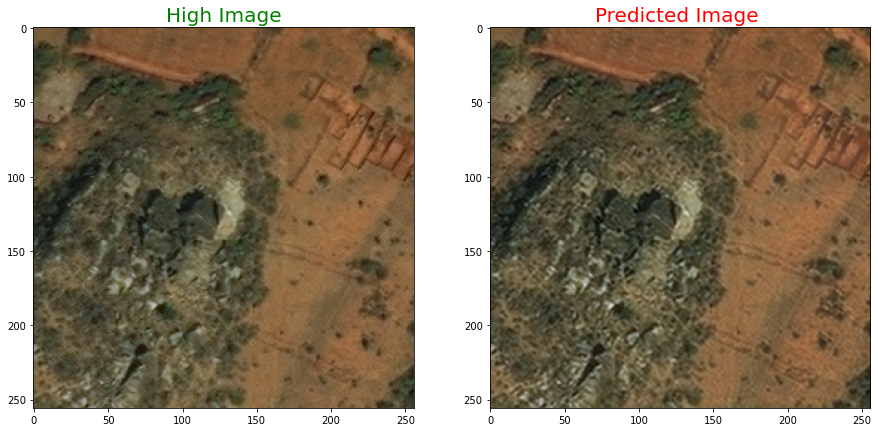

PSNR tf.Tensor(34.36183, shape=(), dtype=float32) dB SSIM tf.Tensor(0.93943566, shape=(), dtype=float32)
1/1 [==============================] - 0s 22ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


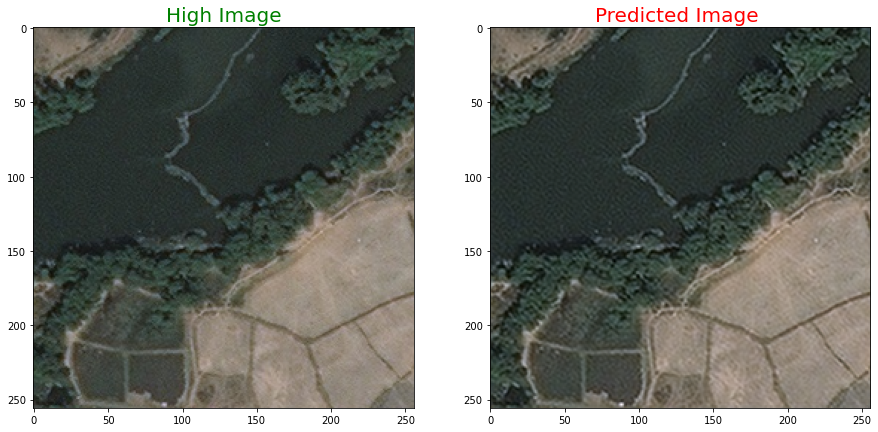

PSNR tf.Tensor(34.636375, shape=(), dtype=float32) dB SSIM tf.Tensor(0.9273513, shape=(), dtype=float32)
1/1 [==============================] - 0s 25ms/step


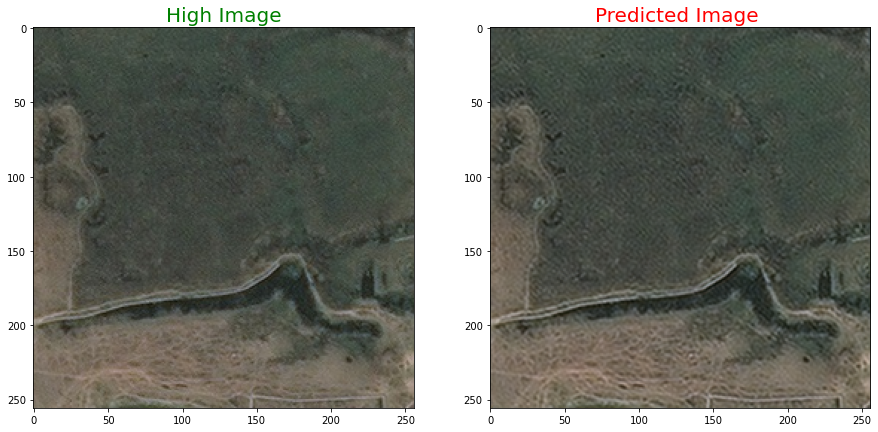

PSNR tf.Tensor(35.59334, shape=(), dtype=float32) dB SSIM tf.Tensor(0.91911155, shape=(), dtype=float32)
1/1 [==============================] - 0s 21ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


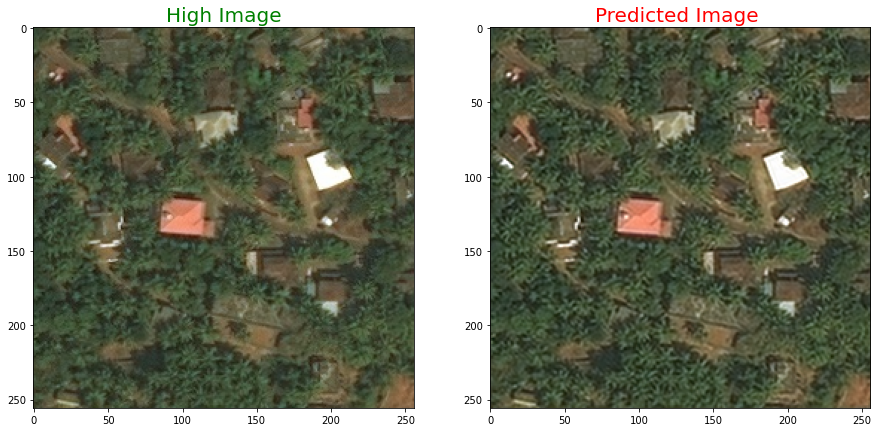

PSNR tf.Tensor(32.968597, shape=(), dtype=float32) dB SSIM tf.Tensor(0.9356348, shape=(), dtype=float32)
1/1 [==============================] - 0s 20ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


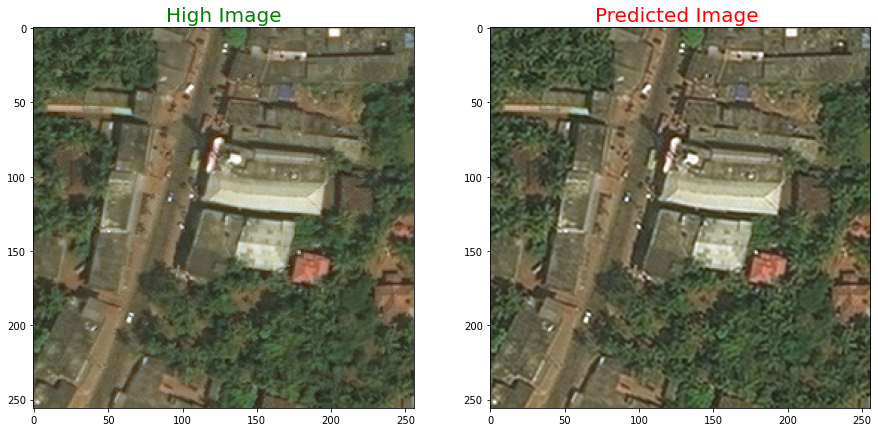

PSNR tf.Tensor(32.604584, shape=(), dtype=float32) dB SSIM tf.Tensor(0.93950987, shape=(), dtype=float32)
1/1 [==============================] - 0s 21ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


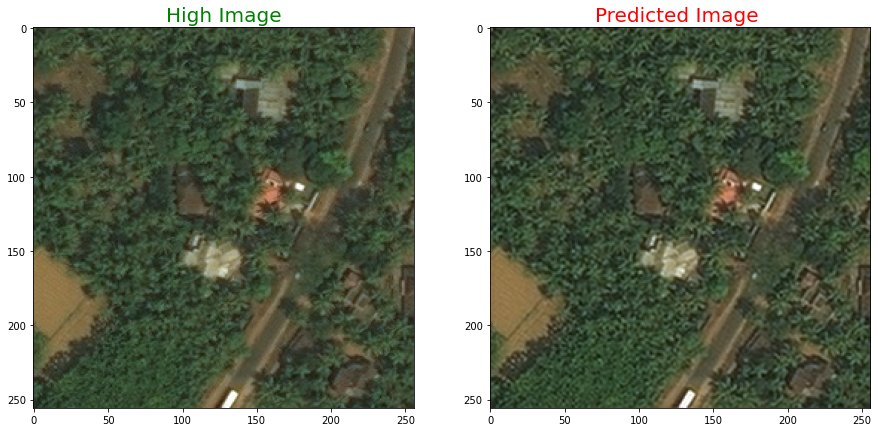

PSNR tf.Tensor(33.351696, shape=(), dtype=float32) dB SSIM tf.Tensor(0.934396, shape=(), dtype=float32)
1/1 [==============================] - 0s 20ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


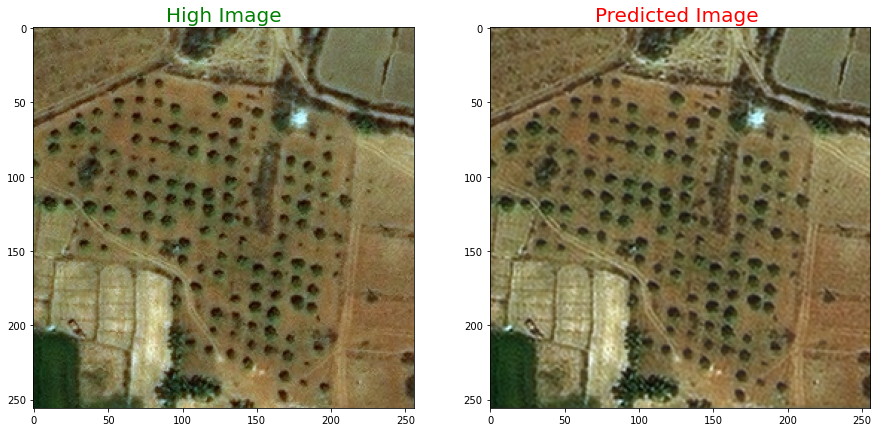

PSNR tf.Tensor(31.238953, shape=(), dtype=float32) dB SSIM tf.Tensor(0.9067142, shape=(), dtype=float32)
1/1 [==============================] - 0s 23ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


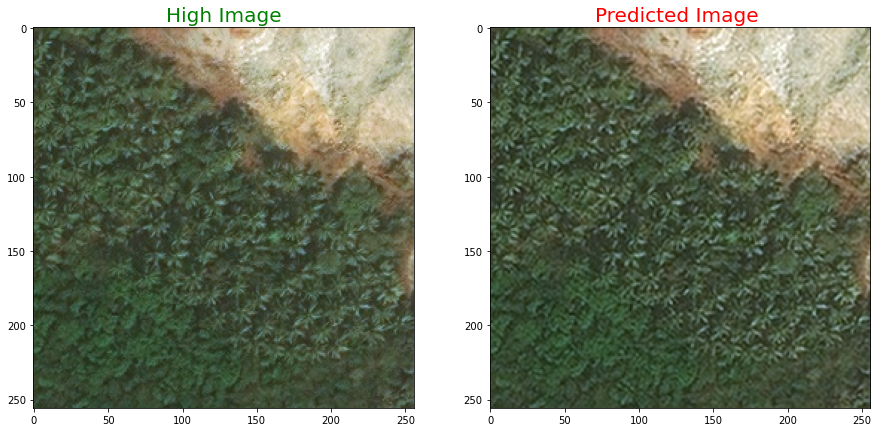

PSNR tf.Tensor(31.656757, shape=(), dtype=float32) dB SSIM tf.Tensor(0.91333514, shape=(), dtype=float32)
Test Score:  33.65945243835449


In [313]:
score = []
for i in range(0,16):
    predicted = his.model.predict(test_high_img[i].reshape(1,256, 256,3)).reshape(256, 256,3)
    plot_images(test_image[i],None,predicted)
    print('PSNR',PSNR(test_high_img[i],predicted.reshape(256,256,3)),'dB', "SSIM",tf.image.ssim(test_high_img[i],predicted.reshape(256,256,3),max_val=1))
    score.append(float(PSNR(test_high_img[i],predicted.reshape(256,256,3))))
print('Test Score: ',sum(score)/len(score))

In [314]:
print('Test Score: ',sum(score)/len(score))

Test Score:  33.65945243835449


##### Saving our model for Future use

In [66]:
SRCNN.save_weights('./checkpoints/SRCNN_weights')


In [31]:
#Testing

###### Preparing Test images 

In [192]:
test_image = cv2.imread('../Num_Res/gart2.png')
t_img = Image.open('../Num_Res/gart2.png')
#test_image = cv2.cvtColor(test_image, cv2.COLOR_BGR2RGB)

In [37]:
t_image = Image.open('../istockphoto-1391003710-612x612.jpg')

In [211]:
#d_image = cv2.resize(test_image, (128, 128), interpolation = cv2.INTER_CUBIC)
        # resize the image - up
d_image = cv2.resize(test_image, (256, 256))
d_image = d_image.astype('float32') / 255.0

In [257]:
pred1 = s_m.model.predict(d_image.reshape(1,256, 256,3)).reshape(512,512,3)
#pred = cv2.normalize(pred, dst=None, alpha=0, beta=255,norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_8U)

1/1 [==============================] - 0s 46ms/step


### Some Result For Our MSRCNN

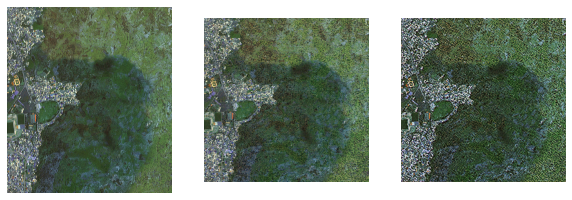

In [258]:
plt.figure(figsize=(10,10))
plt.subplot(1,3,1)
plt.imshow(test_image)
plt.axis('off')
plt.subplot(1,3,2)
plt.imshow(d_image)
plt.axis('off')
plt.subplot(1,3,3)
plt.imshow(pred1)
plt.axis('off')
'''plt.subplot(1,3,3)
plt.imshow(pred)
plt.axis('off')'''
plt.show()

In [259]:
pred = SRCNN.predict(d_image.reshape(1,256, 256,3)).reshape(256, 256,3)

1/1 [==============================] - 0s 46ms/step


#### Result For SRCNN

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


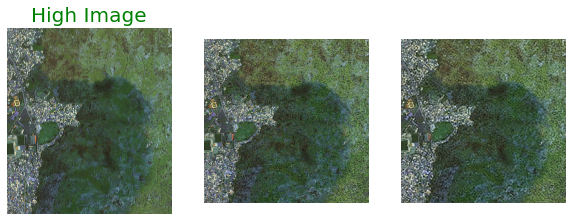

In [261]:
plt.figure(figsize=(10,10))
plt.subplot(1,3,1)
plt.title('High Image', color = 'green', fontsize = 20)
plt.imshow(test_image)
plt.axis('off')
plt.subplot(1,3,2)
plt.imshow(d_image) 
plt.axis('off')
plt.subplot(1,3,3)
plt.imshow(pred)
plt.axis('off')

plt.show()

In [231]:
im_r = cv2.imread('LR.png')

In [233]:
pred = his.model.predict(im_r.reshape(1,256, 256,3)).reshape(256, 256,3)

1/1 [==============================] - 0s 54ms/step


In [235]:
cv2.imwrite('SRCNN_img.png',pred)

True

In [268]:
im_d = im_r.astype('float32') / 255.0
pred1 = s_m.model.predict(im_d.reshape(1,256, 256,3)).reshape(512,512,3)
pred1 = cv2.normalize(pred1, dst=None, alpha=0, beta=255,norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_8U)

1/1 [==============================] - 0s 49ms/step


In [271]:
cv2.imwrite('MSRCNN_img.png',pred1)

True

In [275]:
pred1.shape[0]

512

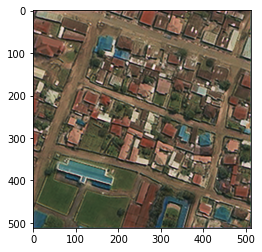

In [272]:
pred1 = cv2.cvtColor(pred1,cv2.COLOR_BGR2RGB)
plt.imshow(pred1)
plt.show()

##### Comparing Predicted images to actual image

In [284]:
#Comparing Predicted images to actual image
img_dir = 'c_res/'
actual = os.path.join(img_dir,'Original.png')
target = cv2.imread(actual).astype('float32') / 255.0
for img_p in os.listdir(img_dir):
    if img_p == 'Original.png':
        pass
    else:
        image = cv2.imread(os.path.join(img_dir,img_p)).astype('float32') / 255.0
        if image.shape[0]!=512:
            image = cv2.resize(image,(512,512))
        a = round(float(PSNR(target,image)),3)
        b = round(float(tf.image.ssim(target,image,max_val=1)),3)
        print(img_p,' Accuracy')
        print('PSNR:',{a},'dB', "SSIM:",{b})

LR.png  Accuracy
PSNR: {33.754} dB SSIM: {0.932}
MSRCNN_img.png  Accuracy
PSNR: {21.524} dB SSIM: {0.698}
SRGAN.png  Accuracy
PSNR: {35.516} dB SSIM: {0.94}
SRCNN_img.png  Accuracy
PSNR: {31.565} dB SSIM: {0.896}
EDSR.png  Accuracy
PSNR: {33.484} dB SSIM: {0.943}


In [316]:
#Saving of Models
s_m.model.save('SRCNN.h5')

/home/wiredu/.local/lib/python3.9/site-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [317]:
his.model.save('MSRCNN.h5')

/home/wiredu/.local/lib/python3.9/site-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
